## Libraries


In [47]:
# Load PyTorch and Essential Libraries
import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.utils.data import Dataset, DataLoader
import sys

# Data augmentation
import albumentations as A
from albumentations.pytorch import ToTensorV2

# Standard libraries
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
from PIL import Image
import os
import pathlib
from tqdm import tqdm

# Geospatial data
import rioxarray as rxr
import rasterio

# Metrics
from sklearn.metrics import accuracy_score, precision_score, recall_score

# File operations
import requests
import pyunpack
from rarfile import RarFile

import os
import glob
import rasterio
import albumentations as A
from albumentations.pytorch import ToTensorV2
import cv2

# Set device
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(f'Using device: {device}')
if torch.cuda.is_available():
    print(f'GPU: {torch.cuda.get_device_name(0)}')
    print(f'Memory: {torch.cuda.get_device_properties(0).total_memory / 1024**3:.2f} GB')

# Set random seeds for reproducibility
torch.manual_seed(42)
np.random.seed(42)
if torch.cuda.is_available():
    torch.cuda.manual_seed(42)

Using device: cuda
GPU: NVIDIA GeForce RTX 4070 Laptop GPU
Memory: 8.00 GB


## Models   


### Standard U-Net  


In [48]:
# Model 1: Standard U-Net

class UNet(nn.Module):
    """
    Standard U-Net architecture.
    Matches TensorFlow implementation exactly.
    
    Architecture:
    - Encoder: 4 blocks (64→128→256→512 filters)
    - Bottleneck: 1024 filters
    - Decoder: 4 blocks with skip connections
    - Output: sigmoid activation
    """
    def __init__(self, in_channels=3, out_channels=1, init_features=64):
        super(UNet, self).__init__()
        
        features = init_features
        
        # Encoder
        self.encoder1 = self._conv_block(in_channels, features)
        self.pool1 = nn.MaxPool2d(kernel_size=2, stride=2)
        
        self.encoder2 = self._conv_block(features, features * 2)
        self.pool2 = nn.MaxPool2d(kernel_size=2, stride=2)
        
        self.encoder3 = self._conv_block(features * 2, features * 4)
        self.pool3 = nn.MaxPool2d(kernel_size=2, stride=2)
        
        self.encoder4 = self._conv_block(features * 4, features * 8)
        self.pool4 = nn.MaxPool2d(kernel_size=2, stride=2)
        
        # Bottleneck
        self.bottleneck = self._conv_block(features * 8, features * 16)
        
        # Decoder
        self.upconv4 = nn.ConvTranspose2d(features * 16, features * 8, kernel_size=2, stride=2)
        self.decoder4 = self._conv_block((features * 8) * 2, features * 8)
        
        self.upconv3 = nn.ConvTranspose2d(features * 8, features * 4, kernel_size=2, stride=2)
        self.decoder3 = self._conv_block((features * 4) * 2, features * 4)
        
        self.upconv2 = nn.ConvTranspose2d(features * 4, features * 2, kernel_size=2, stride=2)
        self.decoder2 = self._conv_block((features * 2) * 2, features * 2)
        
        self.upconv1 = nn.ConvTranspose2d(features * 2, features, kernel_size=2, stride=2)
        self.decoder1 = self._conv_block(features * 2, features)
        
        # Output
        self.conv_out = nn.Conv2d(features, out_channels, kernel_size=1)
        
    def _conv_block(self, in_channels, out_channels):
        """
        Convolutional block: Conv2D → ReLU → Conv2D → ReLU.
        Matches Keras convBlock2() function.
        """
        return nn.Sequential(
            nn.Conv2d(in_channels, out_channels, kernel_size=3, padding=1),
            nn.ReLU(inplace=True),
            nn.Conv2d(out_channels, out_channels, kernel_size=3, padding=1),
            nn.ReLU(inplace=True)
        )
    
    def forward(self, x):
        # Encoder
        enc1 = self.encoder1(x)
        enc2 = self.encoder2(self.pool1(enc1))
        enc3 = self.encoder3(self.pool2(enc2))
        enc4 = self.encoder4(self.pool3(enc3))
        
        # Bottleneck
        bottleneck = self.bottleneck(self.pool4(enc4))
        
        # Decoder with skip connections
        dec4 = self.upconv4(bottleneck)
        dec4 = torch.cat([dec4, enc4], dim=1)
        dec4 = self.decoder4(dec4)
        
        dec3 = self.upconv3(dec4)
        dec3 = torch.cat([dec3, enc3], dim=1)
        dec3 = self.decoder3(dec3)
        
        dec2 = self.upconv2(dec3)
        dec2 = torch.cat([dec2, enc2], dim=1)
        dec2 = self.decoder2(dec2)
        
        dec1 = self.upconv1(dec2)
        dec1 = torch.cat([dec1, enc1], dim=1)
        dec1 = self.decoder1(dec1)
        
        # Output with sigmoid
        out = self.conv_out(dec1) #torch.sigmoid(self.conv_out(dec1))
        
        return out

### Attention Unet

In [49]:
# Model 2: Attention U-Net (PRIMARY MODEL)

class AttentionBlock(nn.Module):
    """
    Attention Gate for Attention U-Net.
    
    Implements the attention mechanism from:
    "Attention U-Net: Learning Where to Look for the Pancreas"
    
    TensorFlow operations converted:
    - K.int_shape() → tensor.shape
    - tf.broadcast_to() → tensor.expand_as()
    - multiply() → *
    """
    def __init__(self, F_g, F_l, F_int):
        """
        Args:
            F_g: number of filters in gating signal
            F_l: number of filters in skip connection
            F_int: number of intermediate filters
        """
        super(AttentionBlock, self).__init__()
        
        # Gating signal pathway
        self.W_g = nn.Sequential(
            nn.Conv2d(F_g, F_int, kernel_size=1, stride=1, padding=0, bias=True),
            #nn.BatchNorm2d(F_int)
        )
        
        # Skip connection pathway
        self.W_x = nn.Sequential(
            nn.Conv2d(F_l, F_int, kernel_size=1, stride=1, padding=0, bias=True),
            #nn.BatchNorm2d(F_int)
        )
        
        # Attention coefficient
        self.psi = nn.Sequential(
            nn.Conv2d(F_int, 1, kernel_size=1, stride=1, padding=0, bias=True),
            #nn.BatchNorm2d(1),
            nn.Sigmoid()
        )
        
        self.relu = nn.ReLU(inplace=True)
        
    def forward(self, g, x):
        """
        Args:
            g: gating signal from decoder (coarser scale)
            x: skip connection from encoder (finer scale)
        
        Returns:
            attention-weighted skip connection
        """
        # Process gating signal
        g1 = self.W_g(g)
        
        # Process skip connection with max pooling to match gating size
        # TF: MaxPooling2D((2,2))(theta_x)

        x1 = self.W_x(x)
        x1 = F.max_pool2d(x1, kernel_size=2, stride=2)

        # Combine and apply attention
        # TF: add([phi_g, theta_x])
        psi = self.relu(g1 + x1)
        psi = self.psi(psi)
        
        # Upsample attention map to match skip connection size
        # TF: UpSampling2D(...) then tf.broadcast_to()
        psi = F.interpolate(psi, size=x.shape[2:], mode='bilinear', align_corners=True)
        
        # Apply attention: multiply with skip connection
        # TF: multiply([upsample_psi, x])
        out = x * psi
        
        return out

class AttentionUNet(nn.Module):
    """
    Attention U-Net architecture.
    Matches TensorFlow UNetAM implementation.
    
    Architecture:
    - Encoder: 4 blocks with progressive filters
    - Bottleneck: Highest filter count
    - Decoder: 4 blocks with attention gates
    - Attention gates applied at each decoder level
    """
    def __init__(self, in_channels=3, out_channels=1, filter_base=16):
        """
        Args:
            in_channels: input channels (3 for RGB, 4 for 4-band)
            out_channels: output channels (1 for binary)
            filter_base: base number of filters (16 in original)
        """
        super(AttentionUNet, self).__init__()
        
        # Calculate filter sizes matching TensorFlow
        # filters = [16, 32, 64, 128, 256]
        filters = [filter_base * (2**i) for i in range(5)]
        
        # Encoder
        self.encoder1 = self._conv_block(in_channels, filters[0])
        self.pool1 = nn.MaxPool2d(2, 2)
        
        self.encoder2 = self._conv_block(filters[0], filters[1])
        self.pool2 = nn.MaxPool2d(2, 2)
        
        self.encoder3 = self._conv_block(filters[1], filters[2])
        self.pool3 = nn.MaxPool2d(2, 2)
        
        self.encoder4 = self._conv_block(filters[2], filters[3])
        self.pool4 = nn.MaxPool2d(2, 2)
        
        # Bottleneck
        self.bottleneck = self._conv_block(filters[3], filters[4])
        
        # Attention gates
        self.att4 = AttentionBlock(F_g=filters[4], F_l=filters[3], F_int=filters[3])
        self.att3 = AttentionBlock(F_g=filters[3], F_l=filters[2], F_int=filters[2])
        self.att2 = AttentionBlock(F_g=filters[2], F_l=filters[1], F_int=filters[1])
        self.att1 = AttentionBlock(F_g=filters[1], F_l=filters[0], F_int=filters[0])
        
        # Decoder
        self.upconv4 = nn.ConvTranspose2d(filters[4], filters[3], kernel_size=2, stride=2)
        self.decoder4 = self._conv_block(filters[4], filters[3])
        
        self.upconv3 = nn.ConvTranspose2d(filters[3], filters[2], kernel_size=2, stride=2)
        self.decoder3 = self._conv_block(filters[3], filters[2])
        
        self.upconv2 = nn.ConvTranspose2d(filters[2], filters[1], kernel_size=2, stride=2)
        self.decoder2 = self._conv_block(filters[2], filters[1])
        
        self.upconv1 = nn.ConvTranspose2d(filters[1], filters[0], kernel_size=2, stride=2)
        self.decoder1 = self._conv_block(filters[1], filters[0])
        
        # Output
        self.conv_out = nn.Conv2d(filters[0], out_channels, kernel_size=1)

        self._init_weights()

    def _init_weights(self):
        for m in self.modules():
            if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
                nn.init.kaiming_normal_(m.weight, mode='fan_out', nonlinearity='relu')
                if m.bias is not None:
                    nn.init.constant_(m.bias, 0)
            elif isinstance(m, nn.BatchNorm2d):
                nn.init.constant_(m.weight, 1)
                nn.init.constant_(m.bias, 0)
        
    def _conv_block(self, in_channels, out_channels):
        """
        Matches convBlock2 from TensorFlow.
        Two convolutions with ReLU activations.
        """
        return nn.Sequential(
            nn.Conv2d(in_channels, out_channels, 3, padding=1),
            nn.ReLU(inplace=True),
            nn.Conv2d(out_channels, out_channels, 3, padding=1),
            nn.ReLU(inplace=True)
        )
    
    def forward(self, x):
        # Encoder
        enc1 = self.encoder1(x)
        enc2 = self.encoder2(self.pool1(enc1))
        enc3 = self.encoder3(self.pool2(enc2))
        enc4 = self.encoder4(self.pool3(enc3))
        
        # Bottleneck
        bottleneck = self.bottleneck(self.pool4(enc4))
        
        # Decoder with attention gates
        # Level 4
        d4 = self.upconv4(bottleneck)
        enc4_att = self.att4(g=bottleneck, x=enc4)
        d4 = torch.cat([d4, enc4_att], dim=1)
        d4 = self.decoder4(d4)
        
        # Level 3
        d3 = self.upconv3(d4)
        enc3_att = self.att3(g=d4, x=enc3)
        d3 = torch.cat([d3, enc3_att], dim=1)
        d3 = self.decoder3(d3)
        
        # Level 2
        d2 = self.upconv2(d3)
        enc2_att = self.att2(g=d3, x=enc2)
        d2 = torch.cat([d2, enc2_att], dim=1)
        d2 = self.decoder2(d2)
        
        # Level 1
        d1 = self.upconv1(d2)
        enc1_att = self.att1(g=d2, x=enc1)
        d1 = torch.cat([d1, enc1], dim=1)#torch.cat([d1, enc1_att], dim=1)#torch.cat([d1, enc1], dim=1)#torch.cat([d1, enc1_att], dim=1)
        d1 = self.decoder1(d1)
        
        # Output
        out = self.conv_out(d1)#torch.sigmoid(self.conv_out(d1))
        
        return out

### ResUNet

In [50]:
class ResBlock(nn.Module):
    """
    Matches 'res_block' from TensorFlow.
    Structure:
    1. Pre-activation (ReLU)
    2. Conv1 (3x3)
    3. ReLU
    4. Conv2 (3x3)
    5. Shortcut (1x1 Conv)
    6. Add
    """
    def __init__(self, in_channels, out_channels, stride=1):
        super(ResBlock, self).__init__()
        
        # TF: x1 = Activation('relu')(x)
        self.relu1 = nn.ReLU(inplace=True)
        
        # TF: x1 = Conv2D(..., strides=strides[0])
        self.conv1 = nn.Conv2d(in_channels, out_channels, kernel_size=3, stride=stride, padding=1)
        
        # TF: x1 = Activation('relu')(x1)
        self.relu2 = nn.ReLU(inplace=True)
        
        # TF: x1 = Conv2D(..., strides=strides[1]) (stride is always 1 for the second conv in TF code)
        self.conv2 = nn.Conv2d(out_channels, out_channels, kernel_size=3, stride=1, padding=1)
        
        # TF: Shortcut (kernel_size=1)
        self.shortcut = nn.Conv2d(in_channels, out_channels, kernel_size=1, stride=stride, padding=0)
        
        self._init_weights()

    def _init_weights(self):
        for m in self.modules():
            if isinstance(m, nn.Conv2d):
                nn.init.kaiming_normal_(m.weight, mode='fan_out', nonlinearity='relu')

    def forward(self, x):
        # TF: x1 = Activation('relu')(x)
        out = self.relu1(x)
        
        # TF: x1 = Conv2D(num_filters[0])(x1)
        out = self.conv1(out)
        
        # TF: x1 = Activation('relu')(x1)
        out = self.relu2(out)
        
        # TF: x1 = Conv2D(num_filters[1])(x1)
        out = self.conv2(out)
        
        # TF: Shortcut applied to ORIGINAL x, not the activated x?
        # WAIT! In TF code: 
        # x1 = Activation('relu')(x) ...
        # x = Conv2D(...)(x) <-- Shortcut takes ORIGINAL x
        # So in PyTorch, we pass 'x' to shortcut, not 'out'.
        shortcut = self.shortcut(x)
        
        return out + shortcut

class ResBlockInitial(nn.Module):
    """
    Matches 'res_block_initial' from TensorFlow.
    Structure:
    1. Conv1 (3x3) (NO pre-activation)
    2. ReLU
    3. Conv2 (3x3)
    4. Shortcut (1x1 Conv)
    5. Add
    """
    def __init__(self, in_channels, out_channels, stride=1):
        super(ResBlockInitial, self).__init__()
        
        # TF: x1 = Conv2D(...) (No initial ReLU)
        self.conv1 = nn.Conv2d(in_channels, out_channels, kernel_size=3, stride=stride, padding=1)
        
        self.relu = nn.ReLU(inplace=True)
        
        self.conv2 = nn.Conv2d(out_channels, out_channels, kernel_size=3, stride=1, padding=1)
        
        self.shortcut = nn.Conv2d(in_channels, out_channels, kernel_size=1, stride=stride, padding=0)
        
        self._init_weights()

    def _init_weights(self):
        for m in self.modules():
            if isinstance(m, nn.Conv2d):
                nn.init.kaiming_normal_(m.weight, mode='fan_out', nonlinearity='relu')

    def forward(self, x):
        out = self.conv1(x)
        out = self.relu(out)
        out = self.conv2(out)
        
        shortcut = self.shortcut(x)
        
        return out + shortcut

class ResUNet(nn.Module):
    def __init__(self, in_channels=3, out_channels=1, filters=[64, 128, 256, 512]):
        super(ResUNet, self).__init__()
        
        # Encoder
        # TF: res_block_initial(x, [64], strides=[1,1])
        self.enc1 = ResBlockInitial(in_channels, filters[0], stride=1)
        
        # TF: res_block(x, [128], strides=[2,1])
        self.enc2 = ResBlock(filters[0], filters[1], stride=2)
        
        # TF: res_block(x, [256], strides=[2,1])
        self.enc3 = ResBlock(filters[1], filters[2], stride=2)
        
        # TF: res_block(x, [512], strides=[2,1])
        self.enc4 = ResBlock(filters[2], filters[3], stride=2)
        
        # Bridge
        # TF: res_block(..., [1024], strides=[2,1])
        self.bridge = ResBlock(filters[3], filters[3]*2, stride=2)
        
        # Decoder
        # TF: UpSampling -> Concatenate -> res_block(..., [512], strides=[1,1])
        
        # Decoder 4 (Input: Bridge 1024 + Enc4 512 = 1536 channels) -> Output 512
        self.dec4 = ResBlock(filters[3]*2 + filters[3], filters[3], stride=1)
        
        # Decoder 3 (Input: Dec4 512 + Enc3 256 = 768 channels) -> Output 256
        self.dec3 = ResBlock(filters[3] + filters[2], filters[2], stride=1)
        
        # Decoder 2 (Input: Dec3 256 + Enc2 128 = 384 channels) -> Output 128
        self.dec2 = ResBlock(filters[2] + filters[1], filters[1], stride=1)
        
        # Decoder 1 (Input: Dec2 128 + Enc1 64 = 192 channels) -> Output 64
        self.dec1 = ResBlock(filters[1] + filters[0], filters[0], stride=1)
        
        # Output
        # TF: Conv2D(num_classes, kernel_size, ..., activation='sigmoid')
        # We assume 3x3 kernel based on 'kernel_size' arg in TF function def
        # Wait, the TF function 'res_unet' defaults 'kernel_size' to undefined, but likely 3.
        # But for 'output', it uses 'kernel_size'.
        self.out = nn.Conv2d(filters[0], out_channels, kernel_size=1, padding=0)
        
        # Init output layer
        nn.init.kaiming_normal_(self.out.weight, mode='fan_out', nonlinearity='relu')

    def forward(self, x):
        # Encoder
        e1 = self.enc1(x)
        e2 = self.enc2(e1)
        e3 = self.enc3(e2)
        e4 = self.enc4(e3)
        
        # Bridge
        b = self.bridge(e4)
        
        # Decoder 4
        d4 = F.interpolate(b, size=e4.shape[2:], mode='bilinear', align_corners=True)
        d4 = torch.cat([d4, e4], dim=1)
        d4 = self.dec4(d4)
        
        # Decoder 3
        d3 = F.interpolate(d4, size=e3.shape[2:], mode='bilinear', align_corners=True)
        d3 = torch.cat([d3, e3], dim=1)
        d3 = self.dec3(d3)
        
        # Decoder 2
        d2 = F.interpolate(d3, size=e2.shape[2:], mode='bilinear', align_corners=True)
        d2 = torch.cat([d2, e2], dim=1)
        d2 = self.dec2(d2)
        
        # Decoder 1
        d1 = F.interpolate(d2, size=e1.shape[2:], mode='bilinear', align_corners=True)
        d1 = torch.cat([d1, e1], dim=1)
        d1 = self.dec1(d1)
        
        # Output (Logits)
        return self.out(d1)

In [51]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
import optuna

# --- AttentionBlock remains unchanged from previous step ---
class AttentionBlock(nn.Module):
    def __init__(self, F_g, F_l, F_int):
        super(AttentionBlock, self).__init__()
        self.W_g = nn.Sequential(
            nn.Conv2d(F_g, F_int, kernel_size=1, stride=1, padding=0, bias=True),
        )
        self.W_x = nn.Sequential(
            nn.Conv2d(F_l, F_int, kernel_size=1, stride=1, padding=0, bias=True),
        )
        self.psi = nn.Sequential(
            nn.Conv2d(F_int, 1, kernel_size=1, stride=1, padding=0, bias=True),
            nn.Sigmoid()
        )
        self.relu = nn.ReLU(inplace=True)

    def forward(self, g, x):
        g1 = self.W_g(g)
        x1 = self.W_x(x)
        x1 = F.max_pool2d(x1, kernel_size=2, stride=2)
        psi = self.relu(g1 + x1)
        psi = self.psi(psi)
        psi = F.interpolate(psi, size=x.shape[2:], mode='bilinear', align_corners=True)
        return x * psi

class FlexibleAttentionUNet(nn.Module):
    """
    Flexible Attention U-Net with Dynamic Depth and Dropout.
    """
    def __init__(self, in_channels=3, out_channels=1, depth=4, filter_base=16, 
                 use_batchnorm=False, dropout_rate=0.0):
        super(FlexibleAttentionUNet, self).__init__()
        self.depth = depth
        self.dropout_rate = dropout_rate
        
        # Dynamic filter calculation
        self.filters = [filter_base * (2**i) for i in range(depth + 1)]
        
        self.encoders = nn.ModuleList()
        self.pools = nn.ModuleList()
        self.decoders = nn.ModuleList()
        self.upconvs = nn.ModuleList()
        self.attentions = nn.ModuleList()
        
        # --- Encoder ---
        current_in = in_channels
        for i in range(depth):
            self.encoders.append(self._conv_block(current_in, self.filters[i], use_batchnorm))
            self.pools.append(nn.MaxPool2d(2, 2))
            current_in = self.filters[i]
            
        # --- Bottleneck ---
        self.bottleneck = self._conv_block(self.filters[depth-1], self.filters[depth], use_batchnorm)
        
        # --- Decoder ---
        for i in range(depth - 1, -1, -1):
            self.upconvs.append(nn.ConvTranspose2d(self.filters[i+1], self.filters[i], kernel_size=2, stride=2))
            self.attentions.append(AttentionBlock(F_g=self.filters[i+1], F_l=self.filters[i], F_int=self.filters[i]))
            # Note: Decoder input filters are doubled due to concatenation
            self.decoders.append(self._conv_block(self.filters[i] * 2, self.filters[i], use_batchnorm))
            
        self.conv_out = nn.Conv2d(self.filters[0], out_channels, kernel_size=1)
        self._init_weights()

    def _conv_block(self, in_c, out_c, batchnorm):
        """
        Constructs a block: Conv -> BN (opt) -> ReLU -> Dropout (opt) -> Conv -> ...
        """
        layers = []
        
        # 1st Conv
        layers.append(nn.Conv2d(in_c, out_c, 3, padding=1))
        if batchnorm: layers.append(nn.BatchNorm2d(out_c))
        layers.append(nn.ReLU(inplace=True))
        
        # Expert Practice: Apply dropout between convolutions to regularize features
        if self.dropout_rate > 0:
            layers.append(nn.Dropout2d(p=self.dropout_rate))
            
        # 2nd Conv
        layers.append(nn.Conv2d(out_c, out_c, 3, padding=1))
        if batchnorm: layers.append(nn.BatchNorm2d(out_c))
        layers.append(nn.ReLU(inplace=True))
        
        # Optional: Additional dropout at the end of the block
        if self.dropout_rate > 0:
            layers.append(nn.Dropout2d(p=self.dropout_rate))
            
        return nn.Sequential(*layers)

    def _init_weights(self):
        for m in self.modules():
            if isinstance(m, (nn.Conv2d, nn.ConvTranspose2d)):
                nn.init.kaiming_normal_(m.weight, mode='fan_out', nonlinearity='relu')

    def forward(self, x):
        skips = []
        
        # Encoder
        for i in range(self.depth):
            x = self.encoders[i](x)
            skips.append(x)
            x = self.pools[i](x)
            
        x = self.bottleneck(x)
        
        # Decoder
        for i in range(self.depth):
            skip = skips[-(i+1)]
            g = x
            x = self.upconvs[i](x)
            attn = self.attentions[i](g=g, x=skip)
            x = torch.cat([x, attn], dim=1)
            x = self.decoders[i](x)
            
        return self.conv_out(x)

In [52]:
model_old_clp = FlexibleAttentionUNet(
    in_channels=4,
    out_channels=1,
    depth=4, 
    filter_base=16,
    use_batchnorm=False,
    dropout_rate=0.0
)

model_new_clp = FlexibleAttentionUNet(
    in_channels=4,
    out_channels=1,
    depth=2, 
    filter_base=64,
    use_batchnorm=False,
    dropout_rate=0.1
)

### Auxiliar function to load models    


In [53]:

# Load Model Example

def load_model(model_class, model_path, in_channels=4, **kwargs):
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    
    # Load the file
    checkpoint = torch.load(model_path, map_location=device)
    
    # Instantiate the model architecture
    model = model_class(in_channels=in_channels, **kwargs)
    
    # Robustly load weights
    if isinstance(checkpoint, dict) and 'model_state_dict' in checkpoint:
        # Case 1: Saved as a dictionary with metadata (e.g., optimizer state, epoch)
        print(f"Loading '{model_path}' from dictionary checkpoint...")
        model.load_state_dict(checkpoint['model_state_dict'])
    else:
        # Case 2: Saved as a direct state_dict
        print(f"Loading '{model_path}' directly from state_dict...")
        model.load_state_dict(checkpoint)

    model.to(device)
    model.eval()
    return model

# Example: Load U-Net RGB
unet_rgb = load_model(UNet, 'models_pytorch/unet-3d.pth', in_channels=3)
# Example: Load Attention U-Net RGB
attn_unet_rgb = load_model(AttentionUNet, 'models_pytorch/attention-unet-3d.pth', in_channels=3)
# Example: Load ResUNet RGB
resunet_rgb = load_model(ResUNet, 'models_pytorch/resunet-3d.pth', in_channels=3)
# Example: Load U-Net 4-Band
unet_4band = load_model(UNet, 'models_pytorch/unet-4band.pth', in_channels=4)
# Example: Load Attention U-Net 4-Band
attn_unet_4band = load_model(AttentionUNet, 'models_pytorch/attention-unet-4d.pth', in_channels=4)

old_clp = load_model(FlexibleAttentionUNet, 'models_pytorch/old_model_attention_unet_clp.pth', in_channels=4, depth=4, filter_base=16, use_batchnorm=False, dropout_rate=0.0)

new_clp = load_model(FlexibleAttentionUNet, 'models_pytorch/best_model_attention_unet_clp.pth', in_channels=4, depth=2, filter_base=64, use_batchnorm=False, dropout_rate=0.1)


/tmp/ipykernel_71454/294278930.py:7: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  checkpoint = torch.load(model_path, map_location=device)


Loading 'models_pytorch/unet-3d.pth' from dictionary checkpoint...
Loading 'models_pytorch/attention-unet-3d.pth' from dictionary checkpoint...
Loading 'models_pytorch/resunet-3d.pth' from dictionary checkpoint...
Loading 'models_pytorch/unet-4band.pth' from dictionary checkpoint...
Loading 'models_pytorch/attention-unet-4d.pth' from dictionary checkpoint...
Loading 'models_pytorch/old_model_attention_unet_clp.pth' directly from state_dict...
Loading 'models_pytorch/best_model_attention_unet_clp.pth' directly from state_dict...


## Dataset and DataLoader

In [54]:
import os
import glob
import numpy as np
import torch
import rasterio
import albumentations as A
from albumentations.pytorch import ToTensorV2
from torch.utils.data import Dataset, DataLoader
import cv2

# --- 1. CONFIGURATION ---
IMG_SIZE = 512
BATCH_SIZE = 2 
NUM_WORKERS = 4

# --- 2. AUGMENTATION PIPELINES ---
# Exact match of your original logic, plus Resize to solve dimension issues.
def get_transforms(split="train"):
    transforms_list = [
        A.Resize(height=IMG_SIZE, width=IMG_SIZE, interpolation=cv2.INTER_LINEAR) # Replaces .reshape(512,512)
    ]
    
    if split == "train":
        transforms_list.extend([
            A.Rotate(limit=180, border_mode=cv2.BORDER_REFLECT_101, p=0.8),
            A.ShiftScaleRotate(shift_limit=0.25, scale_limit=0.25, rotate_limit=0, border_mode=cv2.BORDER_REFLECT_101, p=0.8),
            A.Affine(shear=(-14, 14), p=0.5, border_mode=cv2.BORDER_REFLECT_101),
            A.HorizontalFlip(p=0.8),
            A.VerticalFlip(p=0.8),
            #A.RandomBrightnessContrast(brightness_limit=0.20, contrast_limit=0.20, p=0.5),
        ])
    
    # Normalization & Tensor Conversion
    # Note: For 16-bit TIFFs, we often normalize manually in the Dataset, 
    # but we add ToTensorV2 here to handle HWC -> CHW automatic permutation.
    transforms_list.append(ToTensorV2())
    
    return A.Compose(transforms_list)

# --- 3. ROBUST DATASET CLASS ---
class SatelliteDataset(Dataset):
    def __init__(self, image_paths, mask_paths, transform=None):
        self.image_paths = image_paths
        self.mask_paths = mask_paths
        self.transform = transform

    def __len__(self):
        return len(self.image_paths)

    def __getitem__(self, idx):
        # A. Load Image (TIFF optimized)
        with rasterio.open(self.image_paths[idx]) as src:
            # Transpose (C, H, W) -> (H, W, C) for Albumentations
            image = src.read().transpose(1, 2, 0)
            
            # Replicating your normalization logic:
            # IF your TIFF is 8-bit (0-255), keep / 255.0
            # IF your TIFF is 16-bit (0-65535), change to / 65535.0
            image = image.astype(np.float32) / 255.0 

        # B. Load Mask
        with rasterio.open(self.mask_paths[idx]) as src:
            mask = src.read(1) # Read 1st band
            
            # Replicating your preprocessing: (Mask - 1)
            mask = (mask - 1).astype(np.float32) 
            mask[mask < 0] = 0 # Safety clamp

        h, w = image.shape[:2]
        mh, mw = mask.shape[:2]
                
        # If mask is larger, crop it (matches your old code logic)
        if mh > h or mw > w:
            mask = mask[:h, :w]

        # If mask is smaller (rare, but possible), pad it
        if mh < h or mw < w:
            # Pad with 0 (background)
            pad_h = max(0, h - mh)
            pad_w = max(0, w - mw)
            mask = np.pad(mask, ((0, pad_h), (0, pad_w)), mode='constant', constant_values=0)

        # --- Debugging Check ---
        if image.shape[:2] != mask.shape[:2]:
            print(f"Mismatch found at index {idx}")
            print(f"Image Shape: {image.shape}")
            print(f"Mask Shape: {mask.shape}")
        # -----------------------
        # C. Apply Transforms (Augmentation + Resize)
        if self.transform:
            transformed = self.transform(image=image, mask=mask)
            image = transformed["image"]
            mask = transformed["mask"]

        # D. Final Formatting
        # Image is already Tensor via ToTensorV2
        # Mask needs to be Long (for CrossEntropy) or Float (for Dice)
        # Assuming you want Shape (1, H, W) based on your original code:
        if not isinstance(mask, torch.Tensor):
            mask = torch.from_numpy(mask)
        
        mask = mask.long().unsqueeze(0) # (H,W) -> (1, H, W)

        return image, mask

# --- 4. PATH MANAGEMENT (Replicating your logic) ---
base_dir = "./Amazon Forest Dataset/"

def get_files(folder, suffix=".png"):
    # Robustly matching images to masks by filename
    # Assumes mask has same filename as image but ending in .png
    images = sorted(glob.glob(os.path.join(folder, "images", "*")))
    masks = [
        os.path.join(folder, "masks", os.path.splitext(os.path.basename(img))[0] + suffix)
        for img in images
    ]
    return images, masks

# 1. Get raw lists
train_imgs, train_masks = get_files(os.path.join(base_dir, "Training"))
val_imgs, val_masks = get_files(os.path.join(base_dir, "Validation"))

# 2. Replicate "Move 5 images from Train to Val"
# Indices 25 to 30 (exclusive)
extra_val_imgs = train_imgs[25:30]
extra_val_masks = train_masks[25:30]

# Add to validation
val_imgs.extend(extra_val_imgs)
val_masks.extend(extra_val_masks)

# Remove from training (Keep only first 25)
train_imgs = train_imgs[0:25]
train_masks = train_masks[0:25]

# --- 5. CREATE DATALOADERS ---
train_ds = SatelliteDataset(
    train_imgs, 
    train_masks, 
    transform=get_transforms("train")
)

val_ds = SatelliteDataset(
    val_imgs, 
    val_masks, 
    transform=get_transforms("val")
)

train_loader = DataLoader(train_ds, batch_size=BATCH_SIZE, shuffle=True, num_workers=NUM_WORKERS)
val_loader = DataLoader(val_ds, batch_size=BATCH_SIZE, shuffle=False, num_workers=NUM_WORKERS)

print(f"Training samples: {len(train_ds)}")
print(f"Validation samples: {len(val_ds)}")

Training samples: 25
Validation samples: 20


/home/dhuencho/dev_py/0001_start_pytorch/.venv/lib/python3.12/site-packages/albumentations/core/validation.py:114: UserWarning: ShiftScaleRotate is a special case of Affine transform. Please use Affine transform instead.
  original_init(self, **validated_kwargs)


In [55]:
def get_4band_transforms(split="train", img_size=512):
    transforms_list = [
        # Resize inputs to ensure standard shape
        A.Resize(height=img_size, width=img_size, interpolation=cv2.INTER_LINEAR),
    ]
    
    if split == "train":
        transforms_list.extend([
            # --- GEOMETRIC ONLY (Safe for 4-Band) ---
            # using border_mode=cv2.BORDER_REFLECT_101 (4) to fix black borders
            A.Rotate(limit=180, border_mode=cv2.BORDER_REFLECT_101, p=0.7),
            
            A.ShiftScaleRotate(
                shift_limit=0.25, 
                scale_limit=0.25, 
                rotate_limit=0, 
                border_mode=cv2.BORDER_REFLECT_101, 
                p=0.7
            ),
            
            A.Affine(shear=(-14, 14), border_mode=cv2.BORDER_REFLECT_101, p=0.5),
            A.HorizontalFlip(p=0.7),
            A.VerticalFlip(p=0.7),
            
        ])
    
    transforms_list.append(ToTensorV2())
    return A.Compose(transforms_list)


class FourBandAmazonDataset(Dataset):
    def __init__(self, image_paths, mask_paths, transform=None):
        self.image_paths = image_paths
        self.mask_paths = mask_paths
        self.transform = transform

    def __len__(self):
        return len(self.image_paths)

    def __getitem__(self, idx):
        # A. Load 4-Band Image
        with rasterio.open(self.image_paths[idx]) as src:
            # Read all 4 bands
            # Shape: (4, H, W) -> Transpose to (H, W, 4) for Albumentations
            image = src.read().transpose(1, 2, 0).astype(np.float32)

            # --- NORMALIZATION (Matches your old code) ---
            # Formula: (img - min) / (max - min)
            # Added 1e-8 epsilon to prevent "Divide by Zero" on empty black images
            img_min = image.min()
            img_max = image.max()
            image = (image - img_min) / (img_max - img_min + 1e-8)

        # B. Load Mask
        with rasterio.open(self.mask_paths[idx]) as src:
            mask = src.read(1) # Read 1st band
            # Assuming mask is already 0, 1, 2... if not, subtract 1 like before
            # Based on your old code "rxr.open_rasterio", it seems values are raw
            mask = mask.astype(np.float32)

        # --- FIX: Match Dimensions (The "Bouncer" Logic) ---
        h, w = image.shape[:2]
        mh, mw = mask.shape[:2]
        
        if mh != h or mw != w:
            # Crop mask to match image
            mask = mask[:h, :w]
            # (Optional: Add padding logic here if mask is smaller)

        # C. Apply Transforms
        if self.transform:
            transformed = self.transform(image=image, mask=mask)
            image = transformed["image"]
            mask = transformed["mask"]

        # D. Final Formatting
        if not isinstance(mask, torch.Tensor):
            mask = torch.from_numpy(mask)
        
        # CrossEntropy expects (H, W), Dice expects (1, H, W)
        # We'll use (H, W) standard for now
        mask = mask.long()

        return image, mask


base_dir2 = r"./AMAZON/"

def get_4band_files(base_dir, split="Training"):
    # Define folder names based on the split (handling the inconsistency)
    if split == "Training":
        img_folder, mask_folder = "image", "label"
    elif split == "Test":
        img_folder, mask_folder = "image", "mask"
    elif split == "Validation":
        img_folder, mask_folder = "images", "masks"
        
    # Get Paths
    img_path = os.path.join(base_dir, split, img_folder)
    mask_path = os.path.join(base_dir, split, mask_folder)
    
    # Get List
    image_files = sorted(glob.glob(os.path.join(img_path, "*")))
    
    # Match masks (Assuming same filename)
    mask_files = []
    for img in image_files:
        filename = os.path.basename(img)
        mask_files.append(os.path.join(mask_path, filename))
        
    return image_files, mask_files

# --- LOAD DATA ---
# 1. Get Lists
train_imgs, train_masks = get_4band_files(base_dir2, "Training")
val_imgs, val_masks = get_4band_files(base_dir2, "Validation")

# 2. Create Datasets (Don't forget the transform!)
train_ds_4band = FourBandAmazonDataset(
    train_imgs, 
    train_masks, 
    transform=get_4band_transforms("train")
)

val_ds_4band = FourBandAmazonDataset(
    val_imgs, 
    val_masks, 
    transform=get_4band_transforms("val")
)

# 3. DataLoaders
train_loader_4band = DataLoader(train_ds_4band, batch_size=2, shuffle=True, num_workers=2)
val_loader_4band = DataLoader(val_ds_4band, batch_size=2, shuffle=False, num_workers=2)

print("✅ 4-Band Pipeline Ready")    

✅ 4-Band Pipeline Ready


In [56]:
base_dir2 = r"./chile/"

def get_4band_files(base_dir, split="Training"):
    # Define folder names based on the split (handling the inconsistency)
    if split == "Training":
        img_folder, mask_folder = "image", "label"
    elif split == "Test":
        img_folder, mask_folder = "image", "mask"
    elif split == "Validation":
        img_folder, mask_folder = "images", "masks"
        
    # Get Paths
    img_path = os.path.join(base_dir, split, img_folder)
    mask_path = os.path.join(base_dir, split, mask_folder)
    
    # Get List
    image_files = sorted(glob.glob(os.path.join(img_path, "*")))
    
    # Match masks (Assuming same filename)
    mask_files = []
    for img in image_files:
        filename = os.path.basename(img)
        mask_files.append(os.path.join(mask_path, filename))
        
    return image_files, mask_files

# --- LOAD DATA ---
# 1. Get Lists
#train_imgs, train_masks = get_4band_files(base_dir2, "Training")
val_imgs, val_masks = get_4band_files(base_dir2, "Validation")

# 2. Create Datasets (Don't forget the transform!)
# train_ds_4band = FourBandAmazonDataset(
#     train_imgs, 
#     train_masks, 
#     transform=get_4band_transforms("train")
# )

val_ds_4band_cl = FourBandAmazonDataset(
    val_imgs, 
    val_masks, 
    transform=get_4band_transforms("val")
)

# 3. DataLoaders
#train_loader_4band = DataLoader(train_ds_4band, batch_size=2, shuffle=True, num_workers=2)
val_loader_4band_cl = DataLoader(val_ds_4band_cl, batch_size=2, shuffle=False, num_workers=2)

print("✅ 4-Band Pipeline Ready") 

✅ 4-Band Pipeline Ready



VISUALIZING VALIDATION DATA (Should be standard):
--- Visualizing 3 Samples from 4-Band Dataset ---


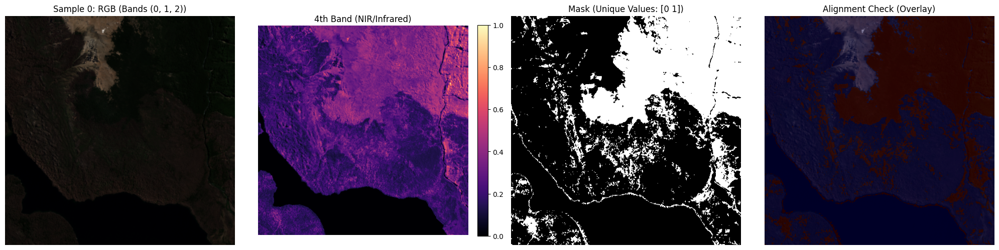

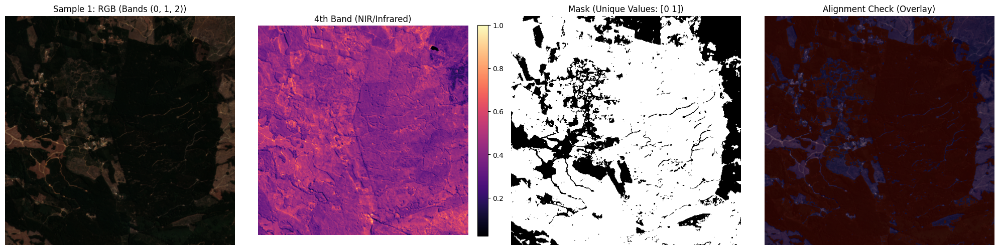

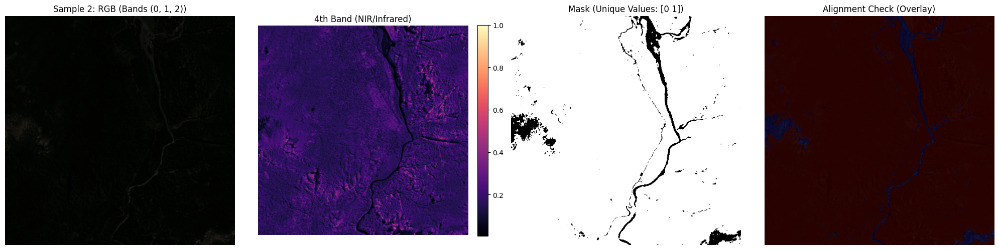

In [39]:

def visualize_4band_dataset(dataset, num_samples=3, band_order=(0, 1, 2)):
    """
    Visualizes 4-band imagery by splitting it into RGB and the 4th Band (NIR).
    
    Args:
        dataset: Your PyTorch dataset (FourBandAmazonDataset)
        num_samples: How many images to show
        band_order: Indices of (Red, Green, Blue) bands. 
                    Default (0,1,2) assumes the Tiff is saved as R-G-B-NIR.
    """
    
    # Create a small loader to get a batch
    # We use batch_size=1 just to grab samples easily
    loader = torch.utils.data.DataLoader(dataset, batch_size=1, shuffle=True)
    
    print(f"--- Visualizing {num_samples} Samples from 4-Band Dataset ---")
    
    for i, (image, mask) in enumerate(loader):
        if i >= num_samples:
            break
            
        # 1. Unpack Tensor: (1, 4, H, W) -> (4, H, W)
        img_tensor = image.squeeze(0)
        mask_tensor = mask.squeeze(0)
        
        # 2. Extract RGB Channels for display
        # We assume the image is already normalized 0-1 by your Dataset class
        r_band = img_tensor[band_order[0], :, :].numpy()
        g_band = img_tensor[band_order[1], :, :].numpy()
        b_band = img_tensor[band_order[2], :, :].numpy()
        
        # Stack them to create a standard RGB image for Matplotlib
        rgb_img = np.stack([r_band, g_band, b_band], axis=-1)
        
        # 3. Extract the 4th Band (Usually NIR - Near Infrared)
        # We assume it is at index 3 (the last one)
        nir_band = img_tensor[3, :, :].numpy()
        
        # 4. Process Mask (Remove extra dims)
        mask_img = mask_tensor.squeeze().numpy()

        # --- PLOTTING ---
        fig, ax = plt.subplots(1, 4, figsize=(20, 5))
        
        # A. RGB Composition
        ax[0].imshow(rgb_img)
        ax[0].set_title(f"Sample {i}: RGB (Bands {band_order})")
        ax[0].axis('off')
        
        # B. 4th Band (Heatmap style)
        # We use a colormap to see the signal intensity clearly
        im_nir = ax[1].imshow(nir_band, cmap='magma')
        ax[1].set_title("4th Band (NIR/Infrared)")
        ax[1].axis('off')
        plt.colorbar(im_nir, ax=ax[1], fraction=0.046, pad=0.04)
        
        # C. Ground Truth Mask
        ax[2].imshow(mask_img, cmap='gray')
        ax[2].set_title(f"Mask (Unique Values: {np.unique(mask_img)})")
        ax[2].axis('off')
        
        # D. Overlay (Check Alignment)
        # We plot the mask ON TOP of the RGB image with transparency (alpha)
        ax[3].imshow(rgb_img)
        ax[3].imshow(mask_img, cmap='jet', alpha=0.3) # 30% transparent mask
        ax[3].set_title("Alignment Check (Overlay)")
        ax[3].axis('off')
        
        plt.tight_layout()
        plt.show()

# --- RUN IT ---
# Try checking both Training (Augmented) and Validation (Raw)
# print("VISUALIZING TRAINING DATA (Should show rotation/flips/reflection):")
# visualize_4band_dataset(train_ds_4band, num_samples=3)

print("\nVISUALIZING VALIDATION DATA (Should be standard):")
visualize_4band_dataset(val_ds_4band_cl, num_samples=3)

## Metrics  


In [57]:
import time
import numpy as np
import torch
import matplotlib.pyplot as plt
from sklearn.metrics import jaccard_score

def get_prediction(model, image_tensor, device='cuda'):
    """
    Runs inference on a single image or batch.
    Args:
        model: PyTorch model
        image_tensor: Tensor (C, H, W) or (B, C, H, W)
    Returns:
        pred_mask: Binary numpy array (0 or 1)
    """
    model.eval()
    
    # Handle dimension: Add Batch dim if missing (C, H, W) -> (1, C, H, W)
    if len(image_tensor.shape) == 3:
        image_tensor = image_tensor.unsqueeze(0)
        
    image_tensor = image_tensor.to(device)
    
    with torch.no_grad():
        logits = model(image_tensor)
        probs = torch.sigmoid(logits) # Apply Sigmoid since we removed it from the model
        preds = (probs > 0.5).float() # Threshold at 0.5
        
    # Convert to CPU Numpy for metrics
    return preds.cpu().numpy()

In [58]:
def measure_inference_time(model, device='cuda', input_size=(1, 3, 512, 512)):
    """
    Measures pure inference time on the GPU.
    """
    model.to(device)
    model.eval()
    
    # Create dummy input
    dummy_input = torch.randn(input_size).to(device)
    
    # Warmup GPU (important for accurate timing)
    for _ in range(10):
        _ = model(dummy_input)
        
    torch.cuda.synchronize() # Wait for GPU to finish warmup
    
    start_time = time.time()
    for _ in range(100): # Average over 100 runs
        _ = model(dummy_input)
    torch.cuda.synchronize() # Wait for GPU to finish
    end_time = time.time()
    
    avg_time = (end_time - start_time) / 100
    print(f"Average Inference Time: {avg_time*1000:.2f} ms per image")
    return avg_time

def evaluate_metrics(model, dataloader, device='cuda'):
    """
    Computes Jaccard (IoU) and Dice Score over the entire test set.
    """
    model.eval()
    jaccard_scores = []
    dice_scores = []
    accuracy_scores = []
    mse_scores = []
    
    print(f"Evaluating over {len(dataloader)} batches...")
    
    with torch.no_grad():
        for images, masks in dataloader:
            images = images.to(device)
            # Ensure masks are on CPU numpy for sklearn/manual calc
            masks_np = masks.numpy().flatten()
            
            # Predict
            logits = model(images)
            probs = torch.sigmoid(logits)
            preds = (probs > 0.5).float()
            preds_np = preds.cpu().numpy().flatten()
            probs_np = probs.cpu().numpy().flatten()
            
            # --- Jaccard (IoU) ---
            # 'binary' ensures we check matching 1s (Forest), excluding background
            iou = jaccard_score(masks_np, preds_np, average='binary') 
            jaccard_scores.append(iou)
            
            # --- Dice Coefficient ---
            # Formula: 2*Intersection / (Sum + Epsilon)
            intersection = np.logical_and(masks_np, preds_np).sum()
            dice = (2. * intersection + 1e-6) / (masks_np.sum() + preds_np.sum() + 1e-6)
            dice_scores.append(dice)

            # --- 3. Accuracy ---
            # Fraction of pixels where Prediction matches Truth
            acc = (preds_np == masks_np).mean()
            accuracy_scores.append(acc)
            
            # --- 4. Mean Squared Error (MSE) ---
            # Error between Probability (Continuous) and Truth (Binary)
            mse = ((probs_np - masks_np) ** 2).mean()
            mse_scores.append(mse)

            
    mean_iou = np.mean(jaccard_scores)
    std_iou = np.std(jaccard_scores)
    mean_dice = np.mean(dice_scores)
    std_dice = np.std(dice_scores)  
    mean_acc = np.mean(accuracy_scores)
    std_acc = np.std(accuracy_scores)
    mean_mse = np.mean(mse_scores)
    std_mse = np.std(mse_scores)

    
    print(f"\n--- Results ---")
    print(f"Jaccard Index (IoU): {mean_iou:.4f} ± {std_iou:.4f}")
    print(f"Dice Coefficient:    {mean_dice:.4f} ± {std_dice:.4f}")
    print(f"Accuracy:            {mean_acc:.4f} ± {std_acc:.4f}")
    print(f"MSE:                 {mean_mse:.6f} ± {std_mse:.6f}")
    
    
    return mean_iou, mean_dice

In [59]:
import numpy as np
import matplotlib.pyplot as plt
import torch

def visualize_predictions(model, dataloader, device='cuda', num_samples=3):
    """
    Plots [Image, Mask, Prediction] for 'num_samples' images.
    Calculates and displays Dice Score in the title.
    """
    model.eval()
    
    # 1. Accumulate enough samples
    accumulated_images = []
    accumulated_masks = []
    accumulated_preds = []
    
    # Iterate through the loader until we have enough samples
    for batch_images, batch_masks in dataloader:
        if len(accumulated_images) >= num_samples:
            break
            
        # Move to GPU for prediction
        images_gpu = batch_images.to(device)
        
        with torch.no_grad():
            logits = model(images_gpu)
            probs = torch.sigmoid(logits)
            preds = (probs > 0.5).float()
        
        # Move back to CPU and add to list
        for i in range(len(batch_images)):
            if len(accumulated_images) >= num_samples:
                break
                
            img_np = batch_images[i].permute(1, 2, 0).numpy() # (H, W, C)
            mask_np = batch_masks[i].numpy().squeeze()        # (H, W)
            pred_np = preds[i].cpu().numpy().squeeze()        # (H, W)
            
            accumulated_images.append(img_np)
            accumulated_masks.append(mask_np)
            accumulated_preds.append(pred_np)

    # 2. Plotting
    print(f"Visualizing {len(accumulated_images)} samples...")
    
    plt.figure(figsize=(15, 5 * len(accumulated_images)))
    
    for i in range(len(accumulated_images)):
        # Retrieve arrays
        mask_t = accumulated_masks[i]
        pred_t = accumulated_preds[i]

        # --- METRIC CALCULATION ---
        # Dice = 2 * Intersection / (Sum of pixels in both)
        intersection = np.logical_and(mask_t, pred_t).sum()
        total_pixels = mask_t.sum() + pred_t.sum()
        
        if total_pixels == 0:
            # If both mask and prediction are empty, score is perfect (1.0)
            dice_score = 1.0
        else:
            dice_score = (2. * intersection) / total_pixels

        # Optional: Pixel Accuracy
        accuracy = (mask_t == pred_t).mean()
        # --------------------------

        # A. Original Image
        plt.subplot(len(accumulated_images), 3, i*3 + 1)
        plt.imshow(accumulated_images[i])
        plt.title(f"Sample {i+1}: Satellite Image")
        plt.axis('off')
        
        # B. Ground Truth (Forest=1=White)
        plt.subplot(len(accumulated_images), 3, i*3 + 2)
        plt.imshow(mask_t, cmap='gray', vmin=0, vmax=1)
        plt.title("Ground Truth Mask")
        plt.axis('off')
        
        # C. Model Prediction (WITH SCORE)
        plt.subplot(len(accumulated_images), 3, i*3 + 3)
        plt.imshow(pred_t, cmap='gray', vmin=0, vmax=1)
        
        # Color code the title: Green if good (>0.8), Red if bad
        title_color = 'green' if dice_score > 0.8 else 'red'
        
        plt.title(f"Prediction\nDice: {dice_score:.4f} | Acc: {accuracy:.2f}", 
                  color=title_color, fontweight='bold')
        plt.axis('off')
        
    plt.tight_layout()
    plt.show()

In [64]:
# 2. Check accuracy metrics
measure_inference_time(unet_4band, input_size=(1, 4, 512, 512))
measure_inference_time(attn_unet_4band, input_size=(1, 4, 512, 512))
evaluate_metrics(unet_4band, val_loader_4band)
evaluate_metrics(attn_unet_4band, val_loader_4band)


Average Inference Time: 57.65 ms per image
Average Inference Time: 4.38 ms per image
Evaluating over 50 batches...

--- Results ---
Jaccard Index (IoU): 0.8213 ± 0.1447
Dice Coefficient:    0.8944 ± 0.0951
Accuracy:            0.9295 ± 0.0511
MSE:                 0.053246 ± 0.033335
Evaluating over 50 batches...

--- Results ---
Jaccard Index (IoU): 0.9380 ± 0.0451
Dice Coefficient:    0.9674 ± 0.0248
Accuracy:            0.9741 ± 0.0178
MSE:                 0.019015 ± 0.013105


(np.float64(0.9379889516828405), np.float64(0.9674245187057798))

Average Inference Time: 35.96 ms per image
Evaluating over 10 batches...


/home/dhuencho/dev_py/0001_start_pytorch/.venv/lib/python3.12/site-packages/rasterio/__init__.py:356: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix will be returned.
  dataset = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)
/home/dhuencho/dev_py/0001_start_pytorch/.venv/lib/python3.12/site-packages/rasterio/__init__.py:356: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix will be returned.
  dataset = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)
/home/dhuencho/dev_py/0001_start_pytorch/.venv/lib/python3.12/site-packages/rasterio/__init__.py:356: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix will be returned.
  dataset = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)
/home/dhuencho/dev_py/0001_start_pytorch/.venv/lib/python3.12/site-packages/rasterio/__init__.py:356: NotGeoreferencedWarning: Dataset has no geotransf


--- Results ---
Jaccard Index (IoU): 0.9149 ± 0.0555
Dice Coefficient:    0.9546 ± 0.0316
Accuracy:            0.9525 ± 0.0400
MSE:                 0.036422 ± 0.029687


/home/dhuencho/dev_py/0001_start_pytorch/.venv/lib/python3.12/site-packages/rasterio/__init__.py:356: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix will be returned.
  dataset = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)
/home/dhuencho/dev_py/0001_start_pytorch/.venv/lib/python3.12/site-packages/rasterio/__init__.py:356: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix will be returned.
  dataset = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)
/home/dhuencho/dev_py/0001_start_pytorch/.venv/lib/python3.12/site-packages/rasterio/__init__.py:356: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix will be returned.
  dataset = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)
/home/dhuencho/dev_py/0001_start_pytorch/.venv/lib/python3.12/site-packages/rasterio/__init__.py:356: NotGeoreferencedWarning: Dataset has no geotransf

Visualizing 4 samples...


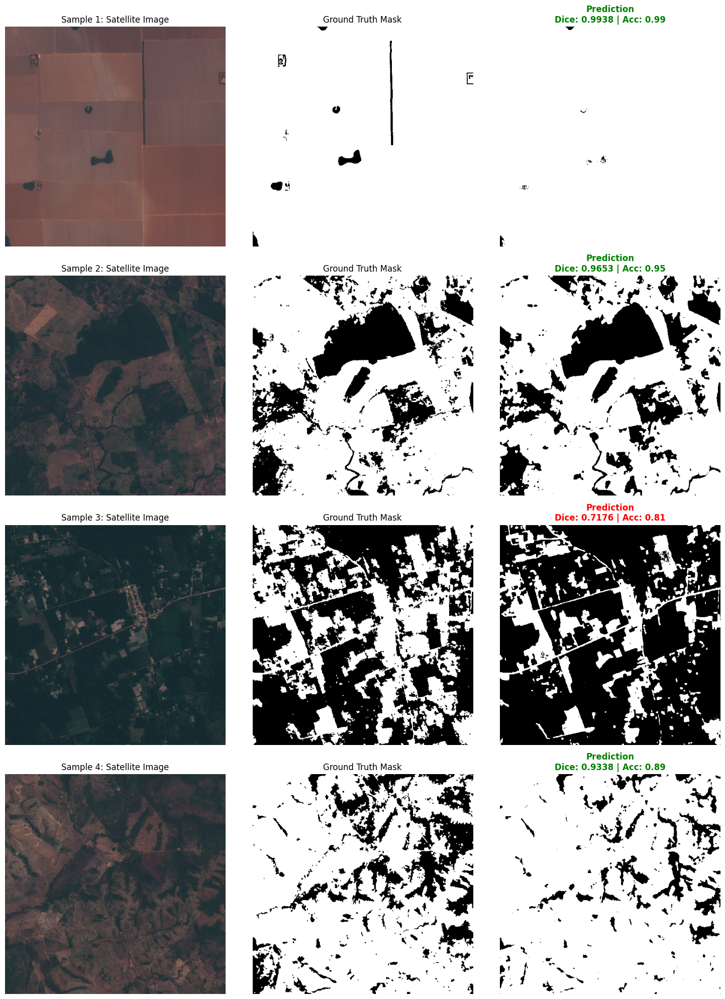

In [60]:
# 1. Check speed
measure_inference_time(unet_rgb)

# 2. Check accuracy metrics
evaluate_metrics(unet_rgb, val_loader)

# 3. See the results
visualize_predictions(unet_rgb, val_loader, num_samples=4)

Average Inference Time: 5.39 ms per image
Evaluating over 10 batches...


/home/dhuencho/dev_py/0001_start_pytorch/.venv/lib/python3.12/site-packages/rasterio/__init__.py:356: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix will be returned.
  dataset = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)
/home/dhuencho/dev_py/0001_start_pytorch/.venv/lib/python3.12/site-packages/rasterio/__init__.py:356: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix will be returned.
  dataset = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)
/home/dhuencho/dev_py/0001_start_pytorch/.venv/lib/python3.12/site-packages/rasterio/__init__.py:356: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix will be returned.
  dataset = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)
/home/dhuencho/dev_py/0001_start_pytorch/.venv/lib/python3.12/site-packages/rasterio/__init__.py:356: NotGeoreferencedWarning: Dataset has no geotransf


--- Results ---
Jaccard Index (IoU): 0.9114 ± 0.0532
Dice Coefficient:    0.9528 ± 0.0300
Accuracy:            0.9510 ± 0.0389
MSE:                 0.036820 ± 0.028126


/home/dhuencho/dev_py/0001_start_pytorch/.venv/lib/python3.12/site-packages/rasterio/__init__.py:356: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix will be returned.
  dataset = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)
/home/dhuencho/dev_py/0001_start_pytorch/.venv/lib/python3.12/site-packages/rasterio/__init__.py:356: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix will be returned.
  dataset = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)
/home/dhuencho/dev_py/0001_start_pytorch/.venv/lib/python3.12/site-packages/rasterio/__init__.py:356: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix will be returned.
  dataset = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)
/home/dhuencho/dev_py/0001_start_pytorch/.venv/lib/python3.12/site-packages/rasterio/__init__.py:356: NotGeoreferencedWarning: Dataset has no geotransf

Visualizing 4 samples...


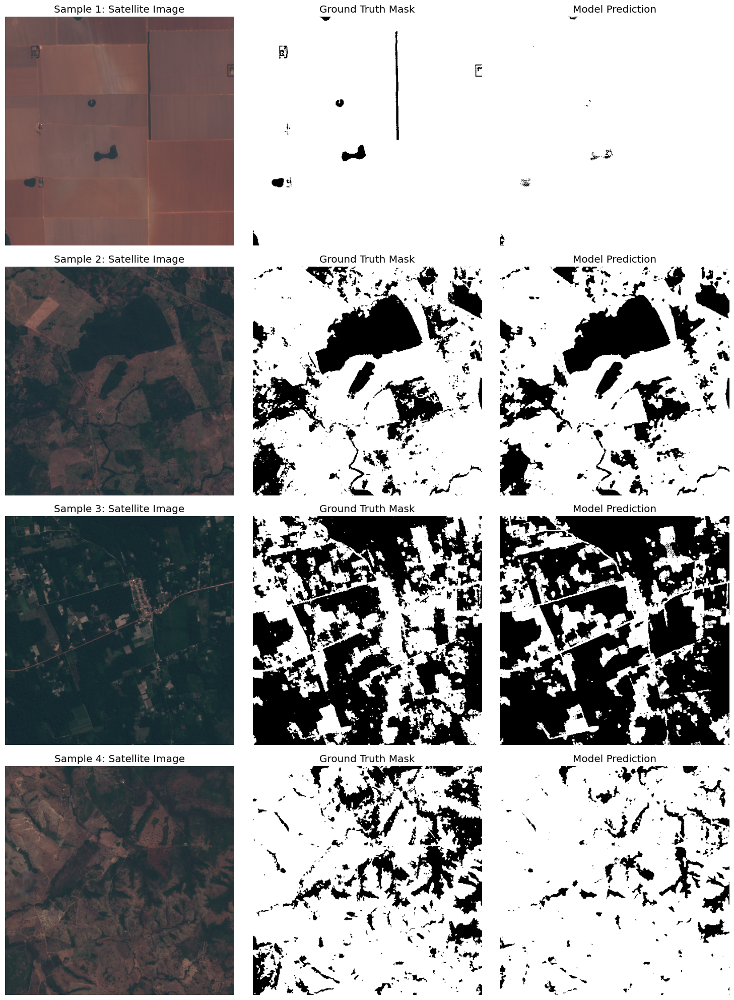

In [84]:
# 1. Check speed
measure_inference_time(attn_unet_rgb)

# 2. Check accuracy metrics
evaluate_metrics(attn_unet_rgb, val_loader)

# 3. See the results
visualize_predictions(attn_unet_rgb, val_loader, num_samples=4)

Average Inference Time: 50.54 ms per image
Evaluating over 10 batches...


/home/dhuencho/dev_py/0001_start_pytorch/.venv/lib/python3.12/site-packages/rasterio/__init__.py:356: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix will be returned.
  dataset = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)
/home/dhuencho/dev_py/0001_start_pytorch/.venv/lib/python3.12/site-packages/rasterio/__init__.py:356: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix will be returned.
  dataset = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)
/home/dhuencho/dev_py/0001_start_pytorch/.venv/lib/python3.12/site-packages/rasterio/__init__.py:356: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix will be returned.
  dataset = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)
/home/dhuencho/dev_py/0001_start_pytorch/.venv/lib/python3.12/site-packages/rasterio/__init__.py:356: NotGeoreferencedWarning: Dataset has no geotransf


--- Results ---
Jaccard Index (IoU): 0.8333 ± 0.1000
Dice Coefficient:    0.9058 ± 0.0602
Accuracy:            0.8936 ± 0.0959
MSE:                 0.078092 ± 0.061764


/home/dhuencho/dev_py/0001_start_pytorch/.venv/lib/python3.12/site-packages/rasterio/__init__.py:356: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix will be returned.
  dataset = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)
/home/dhuencho/dev_py/0001_start_pytorch/.venv/lib/python3.12/site-packages/rasterio/__init__.py:356: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix will be returned.
  dataset = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)
/home/dhuencho/dev_py/0001_start_pytorch/.venv/lib/python3.12/site-packages/rasterio/__init__.py:356: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix will be returned.
  dataset = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)
/home/dhuencho/dev_py/0001_start_pytorch/.venv/lib/python3.12/site-packages/rasterio/__init__.py:356: NotGeoreferencedWarning: Dataset has no geotransf

Visualizing 4 samples...


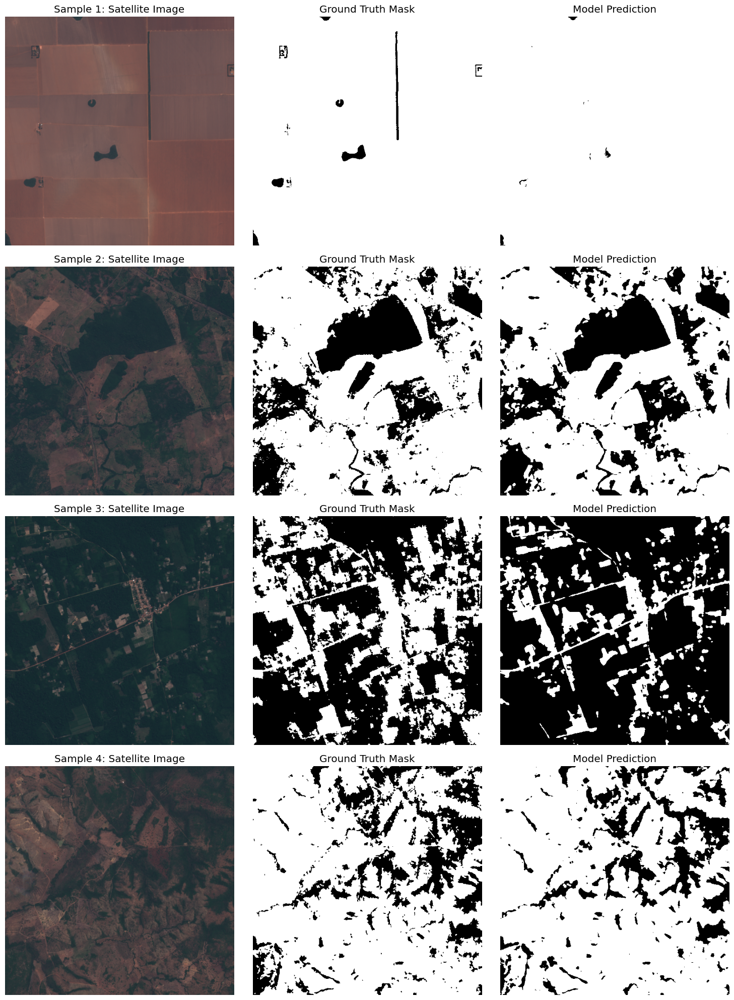

In [85]:
# 1. Check speed
measure_inference_time(resunet_rgb)

# 2. Check accuracy metrics
evaluate_metrics(resunet_rgb, val_loader)

# 3. See the results
visualize_predictions(resunet_rgb, val_loader, num_samples=4)

Average Inference Time: 56.76 ms per image
Evaluating over 50 batches...

--- Results ---
Jaccard Index (IoU): 0.8213 ± 0.1447
Dice Coefficient:    0.8944 ± 0.0951
Accuracy:            0.9295 ± 0.0511
MSE:                 0.053246 ± 0.033335
Visualizing 4 samples...


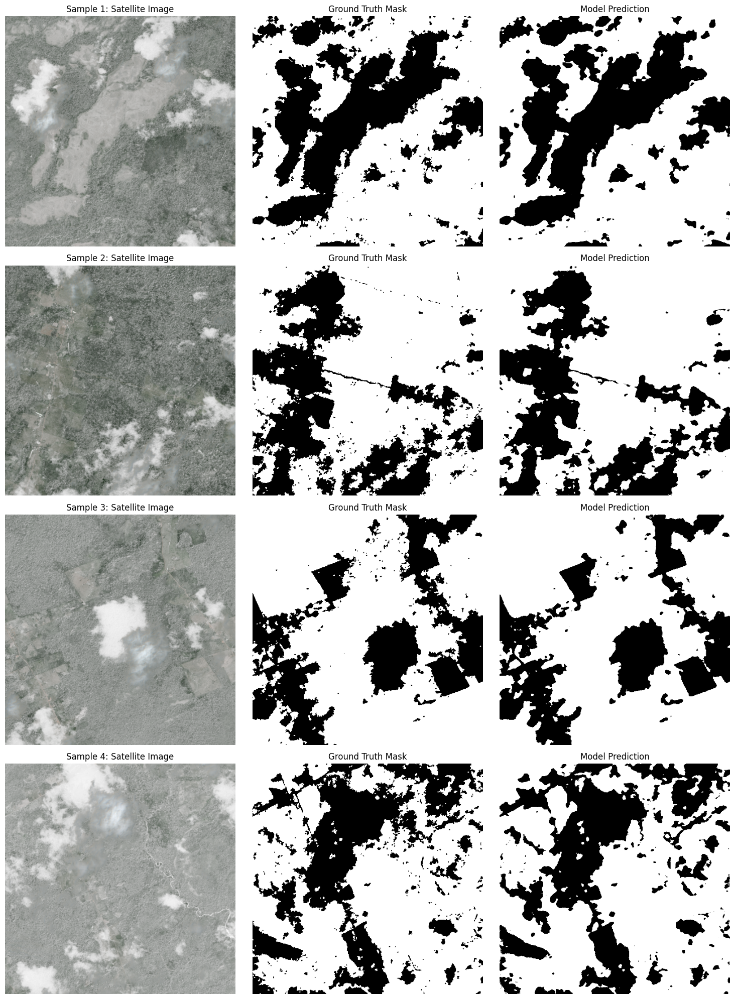

In [36]:
# 1. Check speed
measure_inference_time(unet_4band, input_size=(1, 4, 512, 512))

# 2. Check accuracy metrics
evaluate_metrics(unet_4band, val_loader_4band)

# 3. See the results
visualize_predictions(unet_4band, val_loader_4band, num_samples=4)

Average Inference Time: 4.60 ms per image
Evaluating over 50 batches...

--- Results ---
Jaccard Index (IoU): 0.9380 ± 0.0451
Dice Coefficient:    0.9674 ± 0.0248
Accuracy:            0.9741 ± 0.0178
MSE:                 0.019015 ± 0.013105
Visualizing 4 samples...


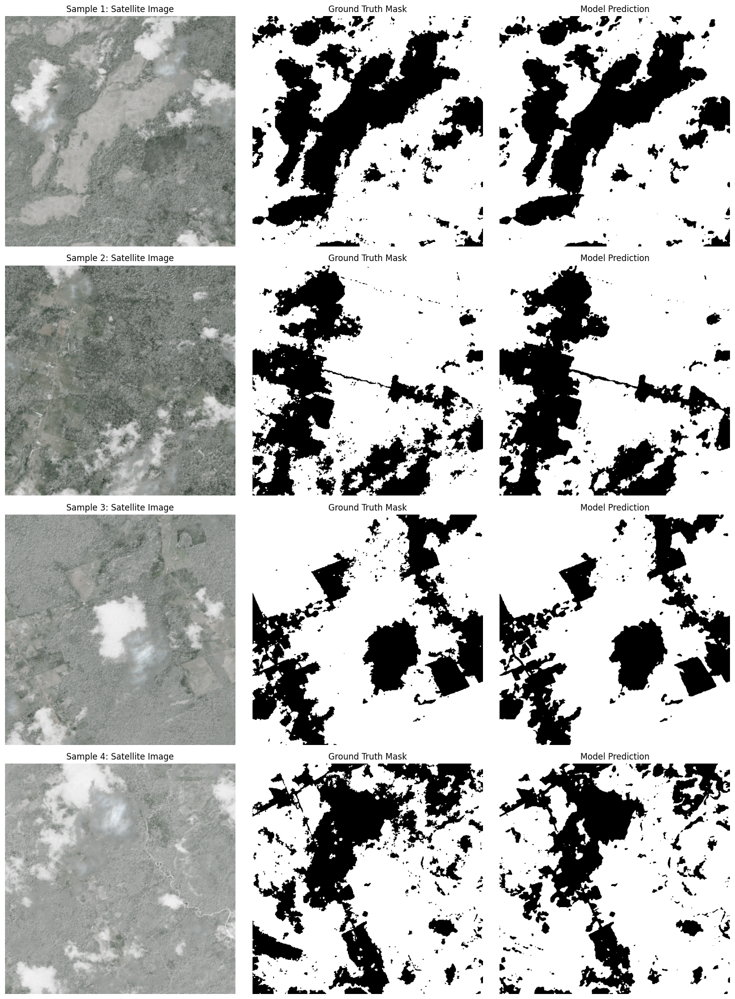

In [37]:
# 1. Check speed
measure_inference_time(attn_unet_4band, input_size=(1, 4, 512, 512))

# 2. Check accuracy metrics
evaluate_metrics(attn_unet_4band, val_loader_4band)

# 3. See the results
visualize_predictions(attn_unet_4band, val_loader_4band, num_samples=4)

In [65]:
base_hist_dir = "./models_pytorch/"

unet_3d_history = np.load(base_hist_dir + 'unet-3d-history.npy', allow_pickle='TRUE').item()
attention_unet_3d_history = np.load(base_hist_dir + 'attention-unet-4d-history.npy', allow_pickle='TRUE').item()
res = np.load(base_hist_dir + 'resunet-3d-history.npy', allow_pickle='TRUE').item()

def plot_acc_loss(model_history, model_name, save_prefix):

    # Update font size globally
    plt.rcParams.update({'font.size': 12})

    # Create a figure with 1 row and 2 columns
    # figsize=(width, height) - (14, 5) makes it wide enough for side-by-side
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(14, 5))

    # --- Plot 1: Accuracy (Left) ---
    ax1.plot(model_history['accuracy'], label='Training')
    ax1.plot(model_history['val_accuracy'], label='Validation')
    ax1.set_title('Model Accuracy')
    ax1.set_ylabel('Accuracy')
    ax1.set_xlabel('Epoch')
    ax1.legend(loc='lower right')
    ax1.grid(True) # Optional: adds a grid for easier reading

    # --- Plot 2: Loss (Right) ---
    ax2.plot(model_history['loss'], label='Training')
    ax2.plot(model_history['val_loss'], label='Validation')
    ax2.set_title('Model Loss')
    ax2.set_ylabel('Loss')
    ax2.set_xlabel('Epoch')
    ax2.legend(loc='upper right')
    ax2.grid(True)

    # Adjust layout to prevent overlapping labels
    plt.tight_layout()

    # Save the combined figure
    plt.savefig('unet-3d-metrics_combined.pdf')
    plt.show()

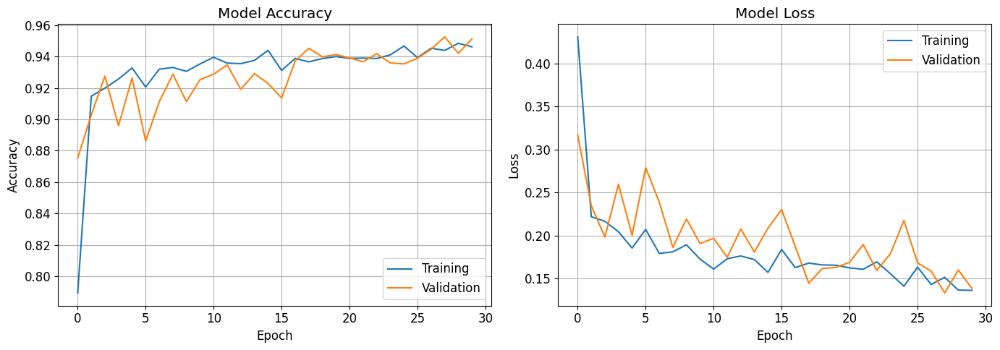

In [78]:

plot_acc_loss(unet_3d_history, 'U-Net 3D', 'unet-3d')   

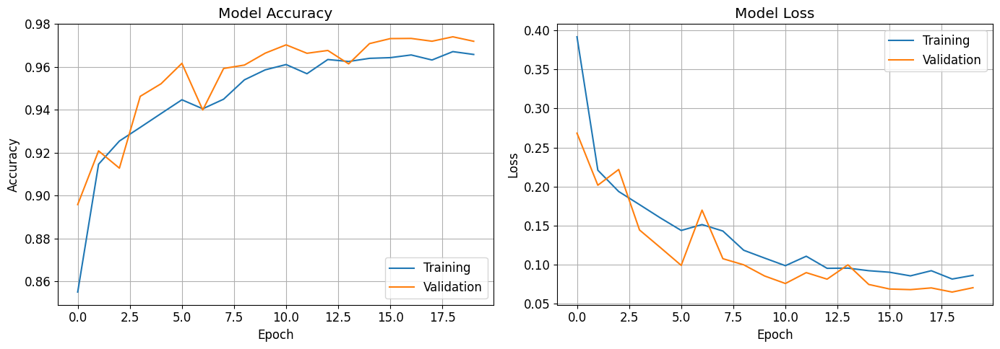

In [66]:
plot_acc_loss(attention_unet_3d_history, '', '')   

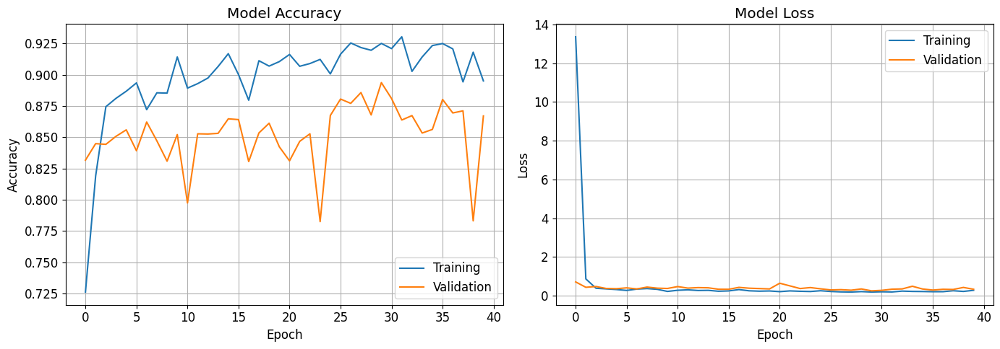

In [80]:
plot_acc_loss(res, '', '')   

## Chile

Average Inference Time: 4.68 ms per image
Evaluating over 20 batches...

--- Results ---
Jaccard Index (IoU): 0.9693 ± 0.0178
Dice Coefficient:    0.9843 ± 0.0094
Accuracy:            0.9827 ± 0.0049
MSE:                 0.013605 ± 0.003701
Visualizing 10 samples...


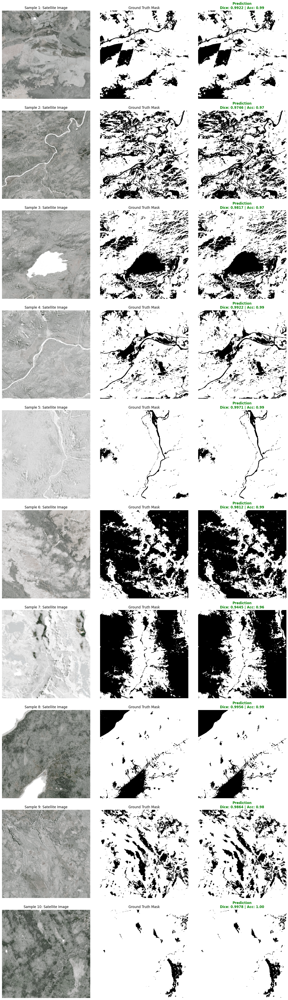

In [45]:
# 1. Check speed
measure_inference_time(old_clp, input_size=(1, 4, 512, 512))

# 2. Check accuracy metrics
evaluate_metrics(old_clp, val_loader_4band_cl)

# 3. See the results
visualize_predictions(old_clp, val_loader_4band_cl, num_samples=10)

Average Inference Time: 27.28 ms per image
Evaluating over 20 batches...

--- Results ---
Jaccard Index (IoU): 0.9572 ± 0.0283
Dice Coefficient:    0.9779 ± 0.0153
Accuracy:            0.9759 ± 0.0075
MSE:                 0.018072 ± 0.005555
Visualizing 10 samples...


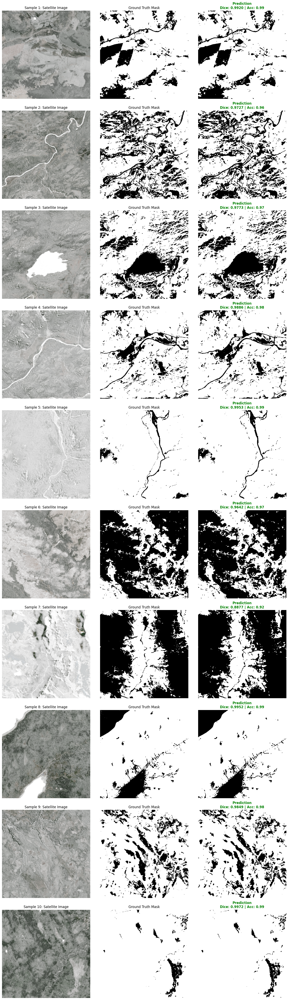

In [46]:
# 1. Check speed
measure_inference_time(new_clp, input_size=(1, 4, 512, 512))

# 2. Check accuracy metrics
evaluate_metrics(new_clp, val_loader_4band_cl)

# 3. See the results
visualize_predictions(new_clp, val_loader_4band_cl, num_samples=10)

Average Inference Time: 4.81 ms per image
Evaluating over 20 batches...

--- Results ---
Jaccard Index (IoU): 0.8614 ± 0.0603
Dice Coefficient:    0.9244 ± 0.0360
Accuracy:            0.9125 ± 0.0437
MSE:                 0.063293 ± 0.031742
Visualizing 10 samples...


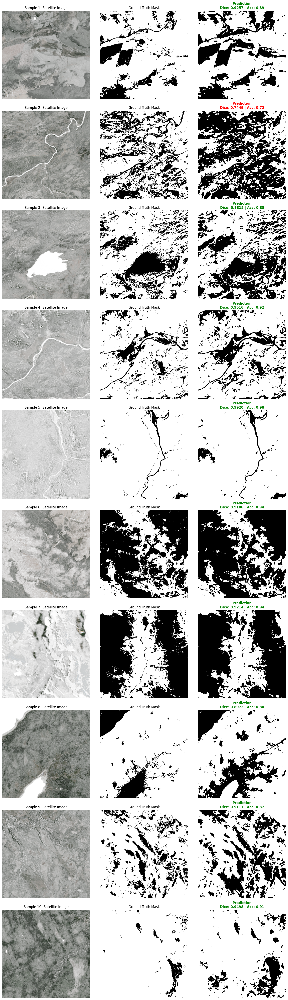

In [43]:
# 1. Check speed
measure_inference_time(attn_unet_4band, input_size=(1, 4, 512, 512))

# 2. Check accuracy metrics
evaluate_metrics(attn_unet_4band, val_loader_4band_cl)

# 3. See the results
visualize_predictions(attn_unet_4band, val_loader_4band_cl, num_samples=10)